<a href="https://colab.research.google.com/github/vf-fontes/intro-cd/blob/master/20_83994_4_Vinicius_Fontes_T1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

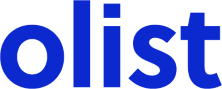

# **OLIST E-COMMERCE**


---


**AUTOR:** Vinicius Fontes
**RA:** 20.83994-4
**GITHUB:** *https://github.com/vf-fontes*


---


**OBJETIVO:**  Analisar a distribuição dos clientes do E-commerce Olist no Brasil.


---


**DATASET USADO:** *https://www.kaggle.com/olistbr/brazilian-ecommerce*


---


**LISTA DE DATASETS:**

*  olist_orders_dataset: Informações sobre as compras realizadas => **[DATASET PRINCIPAL]**
* olist_customers_dataset: Informações sobre os clientes bem como sua localização
* olist_geolocation_dataset: Códigos postais das cidades brasileiras e suas geolocalizações

**DASHBOARD - POWER BI:**

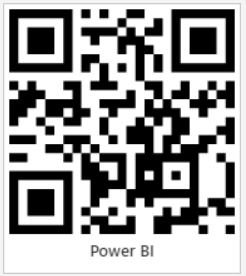

# **1. INSTALANDO BIBLIOTECAS**

In [ ]:
!pip install folium
!pip install gitly

# **2. IMPORTANDO BIBLIOTECAS**

In [ ]:
import pandas as pd
import numpy as np
from gitly.colab.plot import GitlyPlotter
import plotly.express as px
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt

import folium
from folium import plugins
from folium.plugins import MarkerCluster
import datetime

# **3. IMPORTANDO DATASETS**

In [ ]:
df_geolocation = pd.read_csv('/content/drive/MyDrive/01. MBA/MÓDULO - FUNDAMENTOS/00. PROJETOS [Módulo 1]/03. Dashboard - Olist [Tiago]/00. Datasets/olist_geolocation_dataset.csv')
df_customers = pd.read_csv('/content/drive/MyDrive/01. MBA/MÓDULO - FUNDAMENTOS/00. PROJETOS [Módulo 1]/03. Dashboard - Olist [Tiago]/00. Datasets/olist_customers_dataset.csv')
df_orders = pd.read_csv('/content/drive/MyDrive/01. MBA/MÓDULO - FUNDAMENTOS/00. PROJETOS [Módulo 1]/03. Dashboard - Olist [Tiago]/00. Datasets/olist_orders_dataset.csv')

## **3.1 Estrutura dos Datasets**

In [ ]:
df_geolocation.agg(['nunique','count','size'])

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
nunique,19015,717358,717613,8011,27
count,1000163,1000163,1000163,1000163,1000163
size,1000163,1000163,1000163,1000163,1000163


In [ ]:
df_customers.agg(['nunique','count','size'])

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
nunique,99441,96096,14994,4119,27
count,99441,99441,99441,99441,99441
size,99441,99441,99441,99441,99441


In [ ]:
df_orders.agg(['nunique','count','size'])

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
nunique,99441,99441,8,98875,90733,81018,95664,459
count,99441,99441,99441,99441,99281,97658,96476,99441
size,99441,99441,99441,99441,99441,99441,99441,99441


# **4. QUANTIDADE TOTAL DE CLIENTES**

In [ ]:
total_clientes_brasil = df_customers.customer_unique_id.nunique()
print('A plataforma OLIST contém %.i clientes ativos ao redor do Brasil'%total_clientes_brasil)

A plataforma OLIST contém 96096 clientes ativos ao redor do Brasil


# **5. PROPORÇÃO DE CLIENTES POR ESTADO E CIDADE**

Relação em porcentagem da quantidade total de clientes por estado

In [ ]:
df_customer_unique_id_state = df_customers.loc[:,['customer_unique_id','customer_state']]
ranking_estados_clientes = ((df_customer_unique_id_state.groupby(["customer_state"]).nunique().sort_values('customer_unique_id', ascending=False))/total_clientes_brasil)*100
ranking_estados_clientes

,customer_unique_id
customer_state,
SP,41.939311
RJ,12.887113
MG,11.716409
RS,5.491384
PR,5.080336
SC,3.677572
BA,3.410132
DF,2.159299
ES,2.043790


In [ ]:
sudeste = ranking_estados_clientes.loc[(ranking_estados_clientes.index=="SP")|(ranking_estados_clientes.index=="MG")|(ranking_estados_clientes.index=="RJ")].sum()
print('Analisando o gráfico de calor e as porcentagens acima, percebe-se que a Região Sudeste corresponde aproximadamente %.2f%%'%sudeste)

Analisando o gráfico de calor e as porcentagens acima, percebe-se que a Região Sudeste corresponde aproximadamente 66.54%


Conforme é possível analisar no ranking acima, a região sudeste contempla grande maioria dos clientes.

In [ ]:
df_customer_unique_id_state = df_customers.loc[:,['customer_unique_id','customer_state']]
ranking_estados_clientes = df_customer_unique_id_state.groupby(["customer_state"]).nunique().sort_values('customer_unique_id', ascending=False)
total_clientes_sao_paulo = ranking_estados_clientes.loc[(ranking_estados_clientes.index=='SP')]
total_clientes_sao_paulo

,customer_unique_id
customer_state,
SP,40302


In [ ]:
df_customer_unique_id_city = df_customers.loc[:,['customer_unique_id','customer_city']]
ranking_cidades_clientes = ((df_customer_unique_id_city.groupby(["customer_city"]).nunique().sort_values('customer_unique_id', ascending=False))/total_clientes_sao_paulo.iloc  [0,0])*100
ranking_cidades_clientes

,customer_unique_id
customer_city,
sao paulo,37.179296
rio de janeiro,16.425984
belo horizonte,6.629944
brasilia,5.133740
curitiba,3.635055
...,...
ibertioga,0.002481
ibiajara,0.002481
ibiara,0.002481


In [ ]:
sao_paulo = ranking_cidades_clientes.iloc[0,0]
print('Expandindo o Estado de São Paulo, nota-se que a cidade de São Paulo compõem %.2f%% da totalidade dos clientes da OLIST'%sao_paulo)

Expandindo o Estado de São Paulo, nota-se que a cidade de São Paulo compõem 37.18% da totalidade dos clientes da OLIST


# **6. MAPA DE CALOR**

Com este tipo de gráfico dinâmico, facilmente você identifica no mapa do Brasil quais regiões contém maior concentração clientes ativos.

In [ ]:
df_geolocation_sample = df_geolocation.sample(frac=0.5)
coord = []

for lat,lng in zip(df_geolocation_sample.geolocation_lat.values[:], df_geolocation_sample.geolocation_lng.values[:]):
  coord.append([lat,lng])

HeatMap = folium.Map(location=[-16.1237611, -59.9219642], zoom_start=4, tiles='OpenStreetMap')

HeatMap.add_child(plugins.HeatMap(coord,radius=12))
HeatMap

# **7. CURVA DO NÚMERO DE PEDIDOS AO LONGO DO TEMPO**

## **7.1 Merge entre as tabelas df_customers e df_orders**

In [ ]:
df_merged_1 = pd.merge(left=df_customers,right=df_orders, how='left', left_on='customer_id', right_on='customer_id')
df_merged_1

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25 10:35:35,2017-06-05 00:00:00
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,29150127e6685892b6eab3eec79f59c7,delivered,2018-01-12 20:48:24,2018-01-12 20:58:32,2018-01-15 17:14:59,2018-01-29 12:41:19,2018-02-06 00:00:00
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-05-20 16:19:10,2018-06-11 14:31:00,2018-06-14 17:58:51,2018-06-13 00:00:00
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-13 17:29:19,2018-03-27 23:22:42,2018-03-28 16:04:25,2018-04-10 00:00:00
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,2018-07-29 09:51:30,2018-07-29 10:10:09,2018-07-30 15:16:00,2018-08-09 20:55:48,2018-08-15 00:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...
99436,17ddf5dd5d51696bb3d7c6291687be6f,1a29b476fee25c95fbafc67c5ac95cf8,3937,sao paulo,SP,6760e20addcf0121e9d58f2f1ff14298,delivered,2018-04-07 15:48:17,2018-04-07 16:08:45,2018-04-11 02:08:36,2018-04-13 20:06:37,2018-04-25 00:00:00
99437,e7b71a9017aa05c9a7fd292d714858e8,d52a67c98be1cf6a5c84435bd38d095d,6764,taboao da serra,SP,9ec0c8947d973db4f4e8dcf1fbfa8f1b,delivered,2018-04-04 08:20:22,2018-04-04 08:35:12,2018-04-05 18:42:35,2018-04-11 18:54:45,2018-04-20 00:00:00
99438,5e28dfe12db7fb50a4b2f691faecea5e,e9f50caf99f032f0bf3c55141f019d99,60115,fortaleza,CE,fed4434add09a6f332ea398efd656a5c,delivered,2018-04-08 20:11:50,2018-04-08 20:30:03,2018-04-09 17:52:17,2018-05-09 19:03:15,2018-05-02 00:00:00
99439,56b18e2166679b8a959d72dd06da27f9,73c2643a0a458b49f58cea58833b192e,92120,canoas,RS,e31ec91cea1ecf97797787471f98a8c2,delivered,2017-11-03 21:08:33,2017-11-03 21:31:20,2017-11-06 18:24:41,2017-11-16 19:58:39,2017-12-05 00:00:00


## **7.2 Gráfico por ano**

In [ ]:
df_merged_1['order_purchase_timestamp'] = pd.to_datetime(df_merged_1['order_purchase_timestamp'], format="%Y-%m-%d %H:%M:%S")
data_1 = df_merged_1.loc[:,['order_id','order_purchase_timestamp','customer_state']]
data_1['year'] = data_1['order_purchase_timestamp'].dt.year
data_droped_1 = data_1.drop('order_purchase_timestamp',axis=1)
data_droped_1

,order_id,customer_state,year
0,00e7ee1b050b8499577073aeb2a297a1,SP,2017
1,29150127e6685892b6eab3eec79f59c7,SP,2018
2,b2059ed67ce144a36e2aa97d2c9e9ad2,SP,2018
3,951670f92359f4fe4a63112aa7306eba,SP,2018
4,6b7d50bd145f6fc7f33cebabd7e49d0f,SP,2018
...,...,...,...
99436,6760e20addcf0121e9d58f2f1ff14298,SP,2018
99437,9ec0c8947d973db4f4e8dcf1fbfa8f1b,SP,2018
99438,fed4434add09a6f332ea398efd656a5c,CE,2018
99439,e31ec91cea1ecf97797787471f98a8c2,RS,2017


In [ ]:
data_grouped = data_droped_1.groupby(['customer_state','year']).count()
data_grouped = pd.DataFrame(data_grouped)
data_grouped.head(75)

order_id
customer_state year          
AC             2017        54
               2018        27
AL             2016         2
               2017       207
               2018       204
...                       ...
SP             2016       115
               2017     17760
               2018     23871
TO             2017       134
               2018       146

[75 rows x 1 columns]

In [ ]:
data_chart_1 = data_1.groupby('year')['order_id'].count().sort_values(ascending=False)
data_chart_1 = pd.DataFrame(data_chart_1)
data_chart_1.head()

,order_id
year,
2018,54011
2017,45101
2016,329


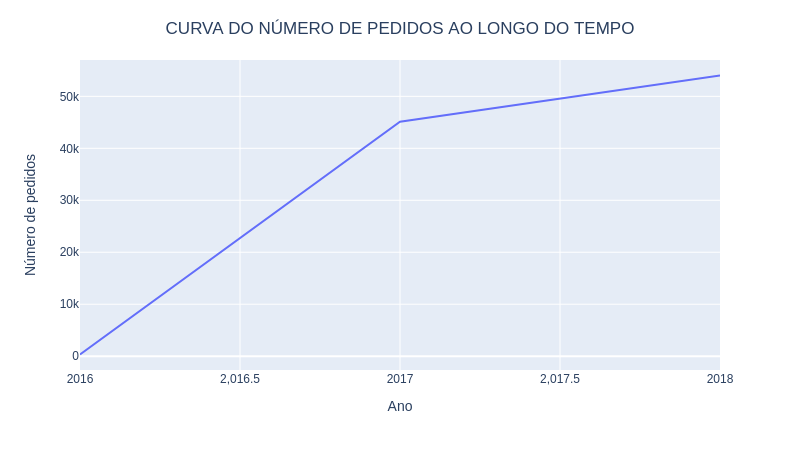

In [ ]:
gitly = GitlyPlotter('github')
fig = px.line(data_chart_1, x=data_chart_1.index, y='order_id', labels={'order_id': 'Número de pedidos', 'year':'Ano'})
fig.update_layout(title={'text' :'CURVA DO NÚMERO DE PEDIDOS AO LONGO DO TEMPO','y': 0.95,'x': 0.5})
fig.update_xaxes()
gitly.show(fig)

Através do gráfico do Número de pedidos ao longo do tempo, é visível que a OLIST vêm ganhando mercado e tendo crescimento positivo.

## **7.3 Gráfico por mês**

In [ ]:
### Criando Dataframe para montar gráfico

df_merged_1['order_purchase_timestamp'] = pd.to_datetime(df_merged_1['order_purchase_timestamp'], format="%Y-%m-%d %H:%M:%S")
data_2 = df_merged_1.loc[:,['order_id','order_purchase_timestamp','customer_state']]
data_2['month'] = data_2['order_purchase_timestamp'].dt.month
data_2['year'] = data_2['order_purchase_timestamp'].dt.year
data_droped_2 = data_2.drop('order_purchase_timestamp',axis=1)

### Gerando Gráficos

ano_min = data_2.year.min()
ano_max = data_2.year.max()
ano_len = data_2.year.nunique()

fig2 = make_subplots( rows=ano_len, cols=1, subplot_titles=("2016", "2017", "2018"),shared_xaxes=True,vertical_spacing=0.10)
n=1

for i in range (ano_min,(ano_max+1)):
  data_subplot = data_droped_2.loc[data_droped_2['year']==i,['order_id','month']]
  data_grouped_2 = data_subplot.groupby('month')['order_id'].count()
  data_grouped_2 = pd.DataFrame(data_grouped_2)
  fig2.add_scatter(x=data_grouped_2.index, y=data_grouped_2.order_id,row=n, col=1, text=data_grouped_2.order_id)
  n=n+1
fig2.update_layout(height=700, width=1000, title={'text' :'CURVA DO NÚMERO DE PEDIDOS AO LONGO DO TEMPO','y': 0.95,'x': 0.5})
fig2.update_layout(showlegend=False)
fig2.show()

Analisando a questão temporal (principalmente 2017), podemos concluir que nos meses de de março, maio, agosto, outubro e novembro existem picos nos pedidos de comprar. Podemos relacionar estes picos aos 'feriados' comerciais existem no Brasil como Dia Internacional das Mulheres (março), Dia das Mães (maio), Dia dos Pais (agosto), Dia das Crianças (outubro) e o grande pico por conta da 'Black Friday' (novembro).

## **7.4 Gráfico por dia nos meses de 2017**

In [ ]:
df_merged_1['order_purchase_timestamp'] = pd.to_datetime(df_merged_1['order_purchase_timestamp'], format="%Y-%m-%d %H:%M:%S")
data_3 = df_merged_1.loc[:,['order_id','order_purchase_timestamp','customer_state']]
data_3['month'] = data_3['order_purchase_timestamp'].dt.month
data_3['year'] = data_3['order_purchase_timestamp'].dt.year
data_3['day'] = data_3['order_purchase_timestamp'].dt.day
data_droped_3 = data_3.drop('order_purchase_timestamp',axis=1)

fig3 = make_subplots( rows=12, cols=1, subplot_titles=('Janeiro','Fevereiro','Abril',"Maio","Junho","Julho","Agosto","Setembro","Outubro","Novembro","Dezembro"),vertical_spacing=0.02)
n=1

for i in range (1,12):
  data_subplot_2 = data_droped_3.loc[(data_droped_3['year']==2017)&(data_droped_3['month']==i),['order_id','day']]
  data_grouped_3 = data_subplot_2.groupby('day')['order_id'].count()
  data_grouped_3 = pd.DataFrame(data_grouped_3)
  fig3.add_scatter(x=data_grouped_3.index, y=data_grouped_3.order_id,row=n, col=1)
  n=n+1

fig3.update_layout(height=3000, width=1000, title={'text' :'CURVA DO NÚMERO DE PEDIDOS AO LONGO DO TEMPO','y': 1,'x': 0.5})
fig3.update_layout(showlegend=False)

fig3.show()

Quando é analisado os dias do mês, podemos deduzir que os picos são exatamente nos dias próximos ao pagamento de salários mais comuns como dia 5,15,20.


# **8. PORQUE DASH_CLIENTES?**

Levando em consideração que um pedido necessariamente deve ser feito por um cliente, entendo que conhecer a clientela do negócio ajuda entender também a variação das vendas e consequentemente o faturamento do período estudado. Portanto entender o comportamento e caraceterísticas do cliente é um dos pontos chaves para o sucesso de um negócio.

# **9. IMPRESSÕES POWER BI X PANDAS**

Através deste projeto fica claro a existência de dois mundos: Manipulação e Extração de Dados (Python) e Interpretação e Visualização Gráfica (Power BI) dos dados em estudo.

Apesar das duas ferramentas ser possível trabalhar com estes dois mundos, a grande diferença é como fazer. 

Power BI é muito mais intuitivo e amigável a um usuário, pois não é necessário entender a fundo o que esta acontecendo no backend. Se você for trabalhar com dados já tratados e 'redondos', basta apenas carregar o seu Dataset e brincar de Criar Dashboards diversos.

Já o Notebook em Python, é uma ferramentas super poderosa para processamento de uma grande massa de dados. Você consegue realizar a Extração, Transformação e Carregamento de dados em questões de segundos. O Python contém diversas bibliotecas para auxiliar desde a conecpção do projeto até a parte de visualização através de gráficos.

Portanto, acredito que ambas ferramentas se completam. O entendimento e insights podem ser realizados no Notebook por conta da capacidade computacional. Após tirar insights, para representação gráfica o Power BI dispõem de mais recursos para gráficos, principalmente por ser um gráfico interativo. Basta você compreender qual delas é a mais adequada para o tipo de Insight que você queira mostrar do seu Dataset.